In [ ]:
# Import required libraries
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras import Model


In [ ]:
# Helper function to load and preprocess images
def load_img(path_to_img):
    img = tf.io.read_file(path_to_img)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.resize(img, [400, 400])
    img = img[tf.newaxis, :]
    return img / 255.0  # Normalize to [0,1]


In [ ]:
# Function to display images
def imshow(image, title=None):
    if len(image.shape) > 3:
        image = tf.squeeze(image, axis=0)
    plt.imshow(image)
    if title:
        plt.title(title)


In [ ]:
# mount google drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os

# set your Google Drive folder path
DRIVE_FOLDER = '/content/drive/MyDrive/'

# List all files and folders in the directory
for filename in os.listdir(DRIVE_FOLDER):
    print(filename)


Colab Notebooks
CIFAR-10
Part1-Build Deep_Architecture .gdoc
Computer_Vision
monet_jpg
photo_jpg
gandido_generator.h5
input_photo_0.png
gandido_transformation_0.png
input_photo_1.png
gandido_transformation_1.png
input_photo_2.png
gandido_transformation_2.png
input_photo_3.png
gandido_transformation_3.png
input_photo_4.png
gandido_transformation_4.png
input_photo_5.png
gandido_transformation_5.png
input_photo_6.png
gandido_transformation_6.png
input_photo_7.png
gandido_transformation_7.png
input_photo_8.png
gandido_transformation_8.png
input_photo_9.png
gandido_transformation_9.png
zurich.jpeg
clear_images
louvre.jpg
starry_night.jpg
image_0.jpg
your_folder
856047.jpg


In [ ]:
# Load and display your content and style images
# set your Google Drive folder path
DRIVE_FOLDER = '/content/drive/MyDrive/'

# set default images
content_path = f'{DRIVE_FOLDER}/856047.jpg'
style_path = f'{DRIVE_FOLDER}/starry_night.jpg'


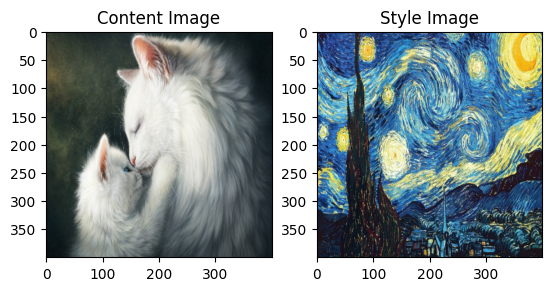

In [ ]:
content_image = load_img('/content/drive/MyDrive/856047.jpg')  # Update the path
style_image = load_img('/content/drive/MyDrive/starry_night.jpg')  # Update the path

plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

In [ ]:
# Define content and style layers
# Here, we define which layers of the InceptionV3 model will be used for content and style extraction.
content_layers = ['mixed6']
style_layers = ['mixed0', 'mixed3', 'mixed5', 'mixed7']



In [ ]:
# Create the feature extraction model
# Load InceptionV3 with pre-trained weights and without the top classification layer
base_model = InceptionV3(include_top=False, weights='imagenet')

# Create the feature extraction model
content_outputs = [base_model.get_layer(name).output for name in content_layers]
style_outputs = [base_model.get_layer(name).output for name in style_layers]
feature_extractor = Model(inputs=base_model.input, outputs=content_outputs + style_outputs)


In [ ]:
# Define Content and Style Loss Functions
def content_loss(content, target):
    return tf.reduce_mean(tf.square(content - target))

def gram_matrix(input_tensor):
    result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
    input_shape = tf.shape(input_tensor)
    num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
    return result/(num_locations)

def style_loss(style, gram_target):
    gram_style = gram_matrix(style)
    return tf.reduce_mean(tf.square(gram_style - gram_target))


In [ ]:
# Extract Style and Content features
style_features, content_features = (feature_extractor(style_image),
                                    feature_extractor(content_image)[:len(content_layers)])


In [ ]:
# Set initial image and optimizer
image = tf.Variable(content_image)
opt = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)


In [ ]:
# Run Style Transfer
# We will perform a few iterations to update the image in a way that minimizes the loss.
#@tf.function()
def train_step(image):
    with tf.GradientTape() as tape:
        # Extract features of generated image
        outputs = feature_extractor(image)

        # Calculate losses
        loss = style_weight * style_loss(style_features, outputs[len(content_layers):]) + \
               content_weight * content_loss(content_features, outputs[:len(content_layers)])

    # Calculate gradients and optimize
    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(tf.clip_by_value(image, 0.0, 1.0))


....................................................................................................

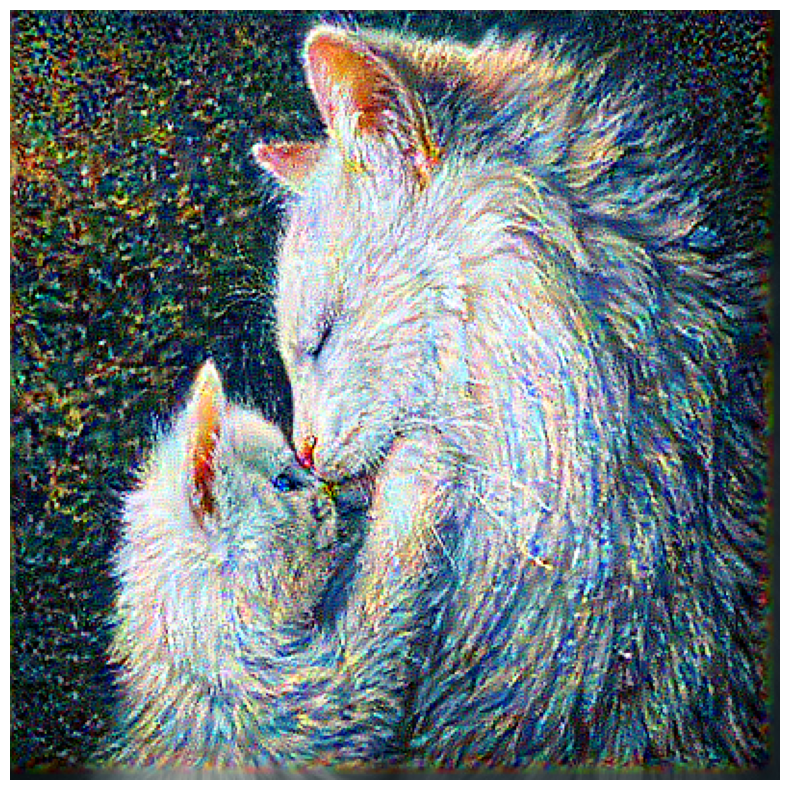

Train step: 100
....................................................................................................

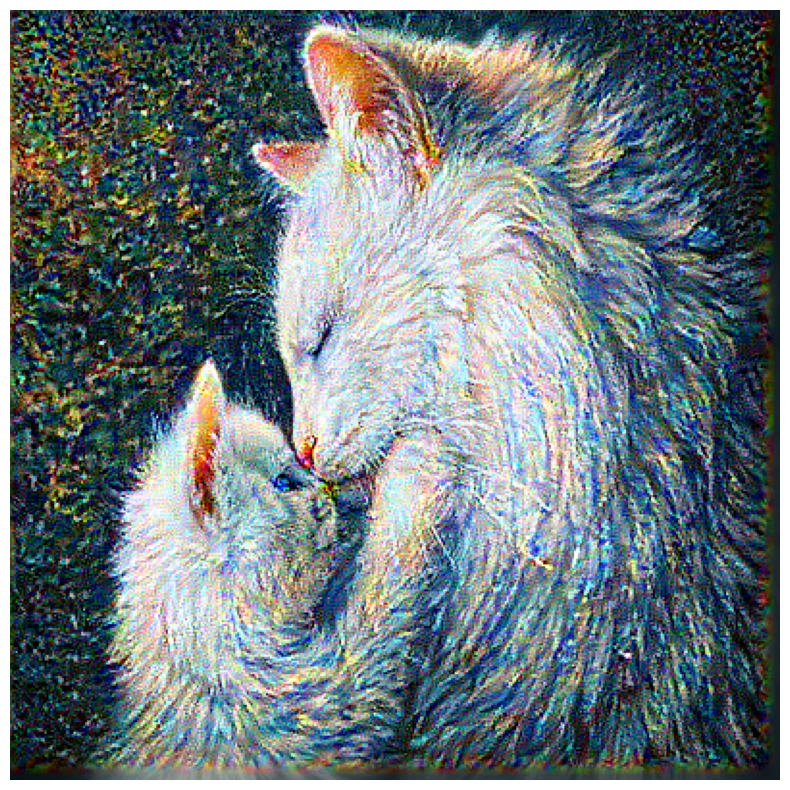

Train step: 200
....................................................................................................

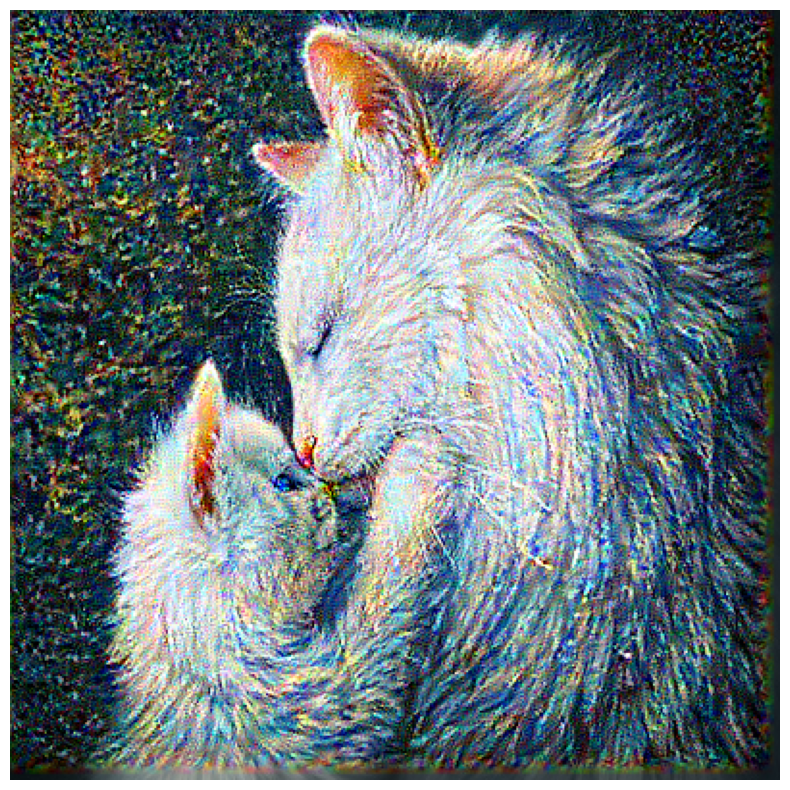

Train step: 300
....................................................................................................

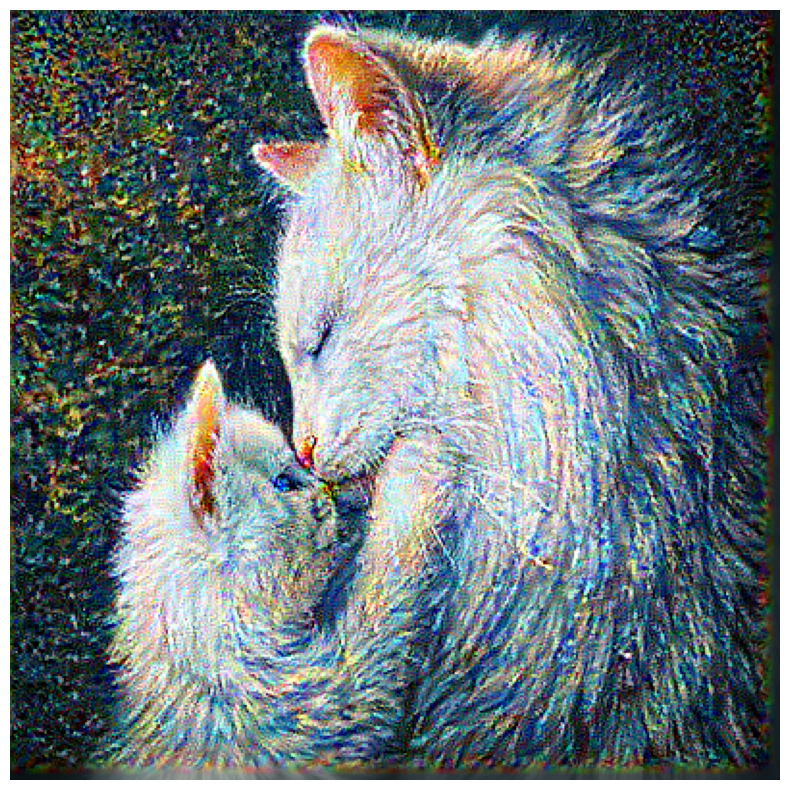

Train step: 400
....................................................................................................

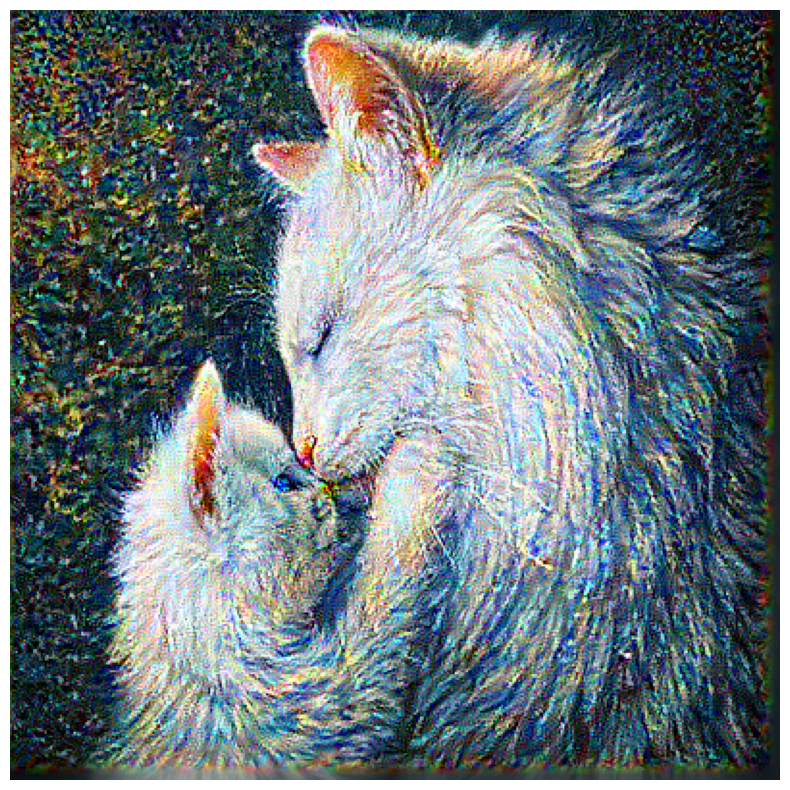

Train step: 500
....................................................................................................

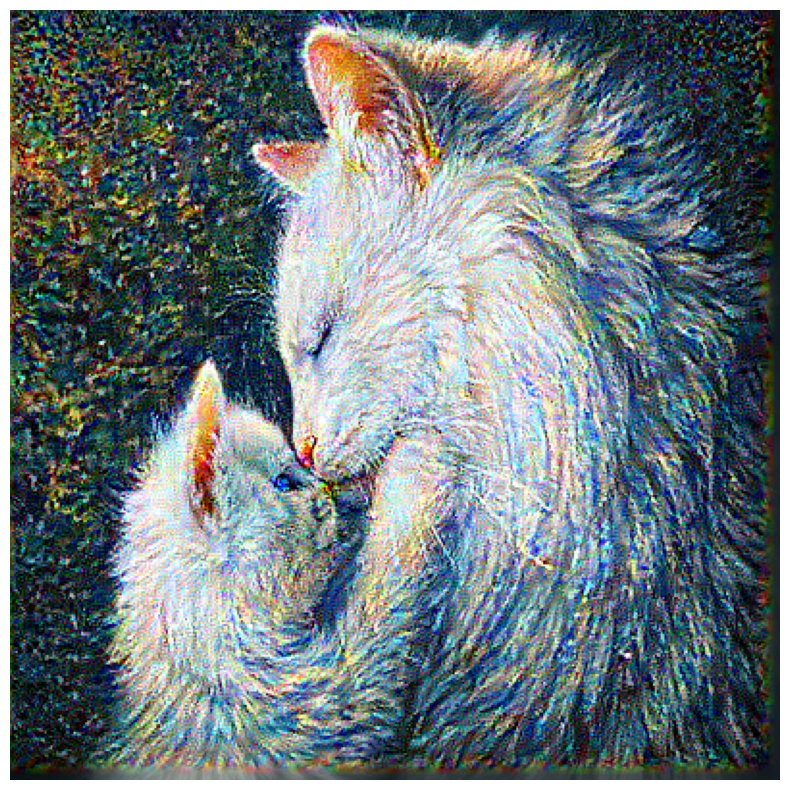

Train step: 600
....................................................................................................

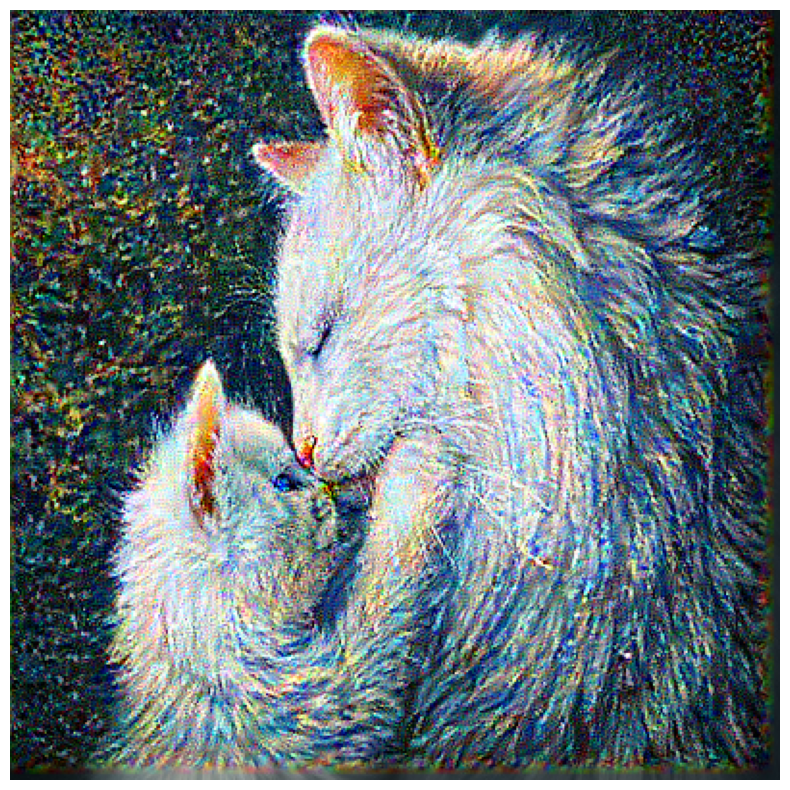

Train step: 700
....................................................................................................

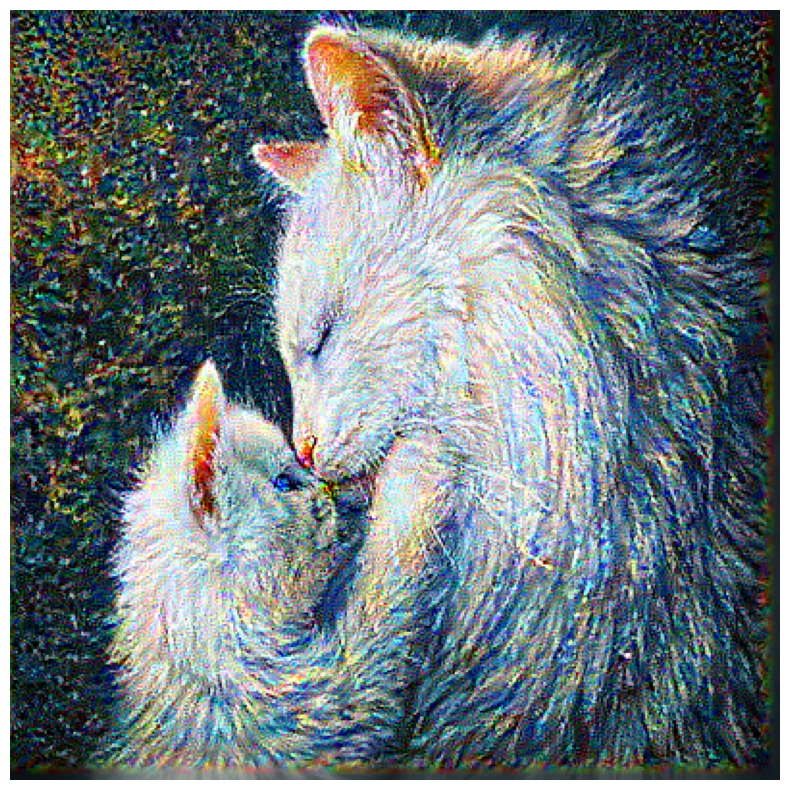

Train step: 800
....................................................................................................

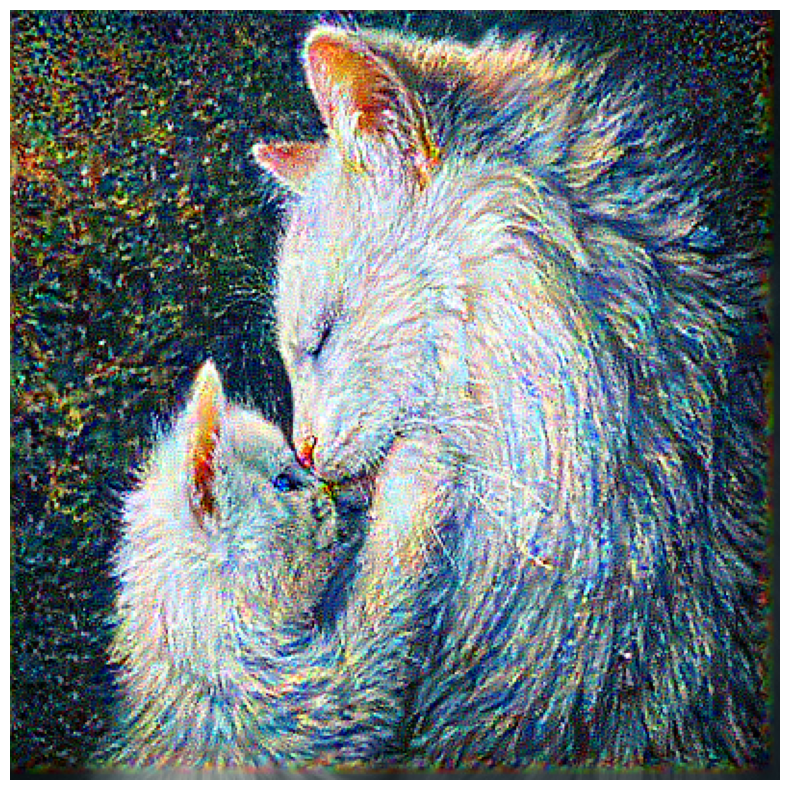

Train step: 900
....................................................................................................

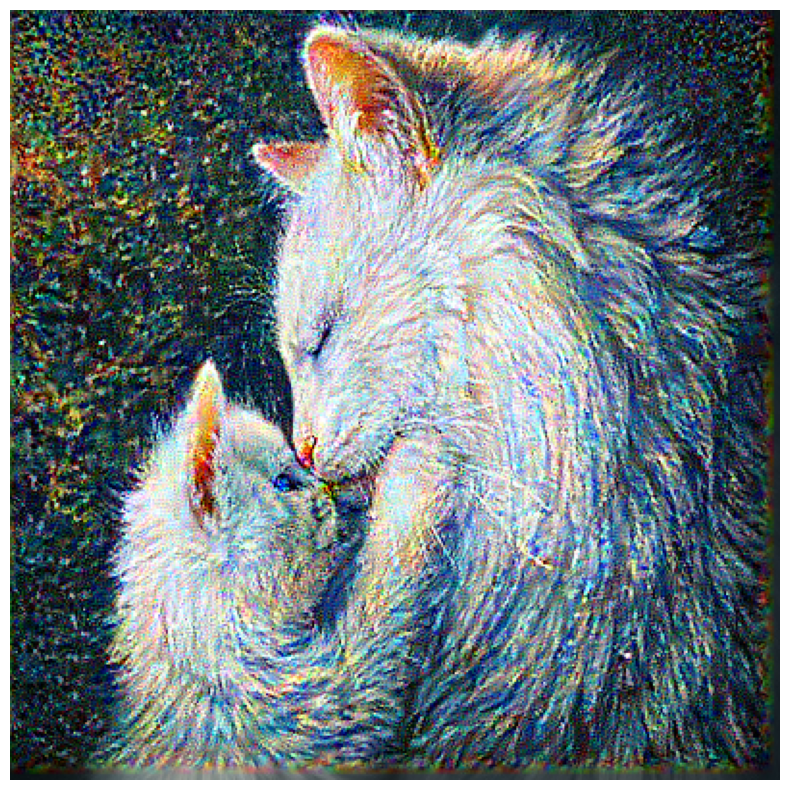

Train step: 1000


In [ ]:
style_weight=1e-2
content_weight=1e4

epochs = 10
steps_per_epoch = 100

step = 0
for n in range(epochs):
    for m in range(steps_per_epoch):
        step += 1
        train_step(image)
        print(".", end='')

        # Display image every 100 steps
        if step % 100 == 0:
            plt.figure(figsize=(10, 10))
            plt.axis('off')
            plt.imshow(tf.squeeze(image).numpy())
            plt.show()

    print("Train step: {}".format(step))


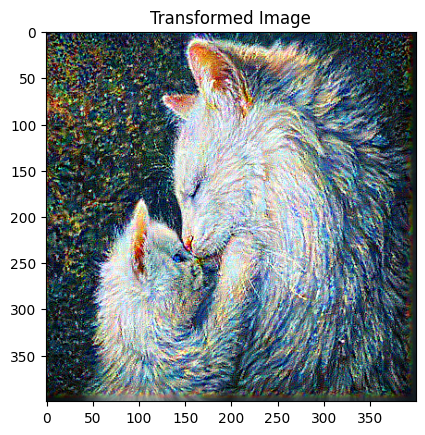

In [ ]:
plt.imshow(tf.squeeze(image, axis=0))
plt.title("Transformed Image")
plt.show()

In [ ]:
# Convert the tensor image to uint8
transformed_img = tf.image.convert_image_dtype(image[0], dtype=tf.uint8)

# Encode the image to PNG format
encoded_img = tf.image.encode_png(transformed_img)


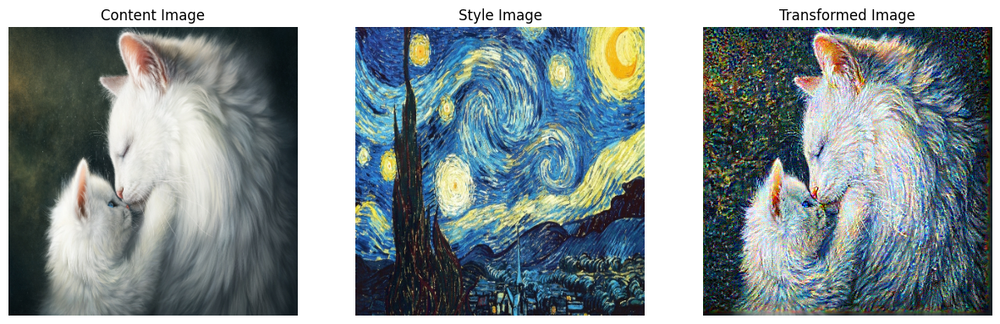

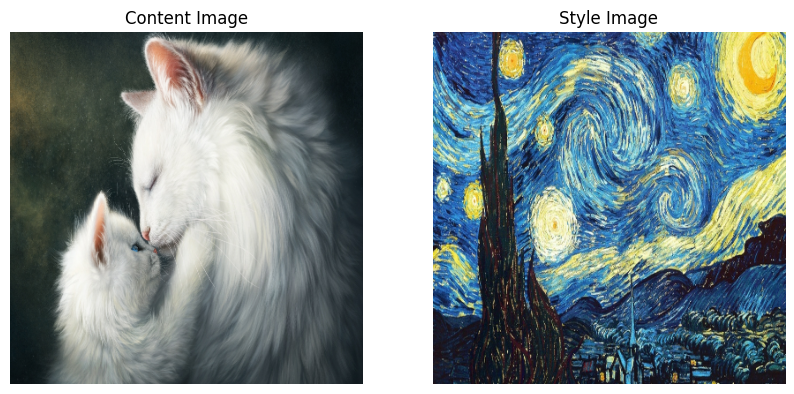

....................................................................................................................................................................


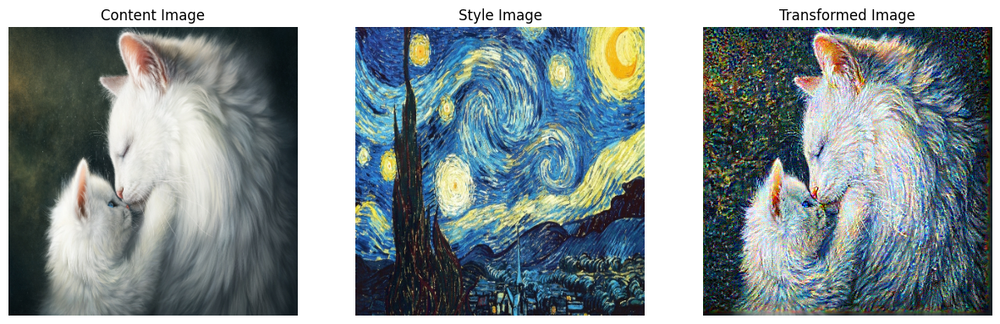

In [ ]:
import matplotlib.pyplot as plt

# Assuming load_img returns a numpy array. Replace with your actual load_img function.
content_image = load_img('/content/drive/MyDrive/856047.jpg')  # Update the path
style_image = load_img('/content/drive/MyDrive/starry_night.jpg')  # Update the path
# Squeeze to remove unnecessary dimensions if the images are tensors
if len(content_image.shape) == 4:
    content_image = tf.squeeze(content_image, axis=0)
if len(style_image.shape) == 4:
    style_image = tf.squeeze(style_image, axis=0)

# Convert tensor to numpy if needed
if isinstance(content_image, tf.Tensor):
    content_image = content_image.numpy()
if isinstance(style_image, tf.Tensor):
    style_image = style_image.numpy()
if isinstance(transformed_img, tf.Tensor):
    transformed_img = transformed_img.numpy()

# Display images
plt.figure(figsize=(15, 5))

# Show content image
plt.subplot(1, 3, 1)
plt.imshow(content_image)
plt.title('Content Image')
plt.axis('off')

# Show style image
plt.subplot(1, 3, 2)
plt.imshow(style_image)
plt.title('Style Image')
plt.axis('off')

# Show transformed image
plt.subplot(1, 3, 3)
plt.imshow(transformed_img)
plt.title('Transformed Image')
plt.axis('off')

plt.show()
# Show content and style images
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(content_image)
plt.title('Content Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(style_image)
plt.title('Style Image')
plt.axis('off')

plt.show()

# Convert tensor to numpy if needed for the transformed image
if isinstance(transformed_img, tf.Tensor):
    transformed_img = transformed_img.numpy()

# Show all images including the transformed image
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(content_image)
plt.title('Content Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(style_image)
plt.title('Style Image')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(transformed_img)
plt.title('Transformed Image')
plt.axis('off')

plt.show()
